# import library

In [ ]:
!pip install tensorflowjs

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.1/89.1 kB 1.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.0/53.0 kB 4.7 MB/s eta 0:00:00
  Attempting uninstall: packaging
    Found existing installation: packaging 24.2
    Uninstalling packaging-24.2:
      Successfully uninstalled packaging-24.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
db-dtypes 1.4.3 requires packaging>=24.2.0, but you have packaging 23.2 which is incompatible.
google-cloud-bigquery 3.32.0 requires packaging>=24.2.0, but you have packaging 23.2 which is incompatible.


In [ ]:
import shutil
import os
import cv2
import random
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import time
import pandas as pd
from google.colab import files

from skimage.transform import warp, AffineTransform, rotate
from skimage.util import random_noise
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.applications import Xception
from tensorflow.keras.models import Model
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D, Input, BatchNormalization
from tensorflow.keras.models import load_model

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# load data

class distribution:
ayam_pop: 489
gulai_tunjang: 519
dendeng_batokok: 295
telur_balado: 520
daging_rendang: 504
gulai_ikan: 307
telur_dadar: 248
soto: 500
rawon: 339
pempek: 409
nasi_goreng: 500
gudeg: 295
gado_gado: 376
bebek_betutu: 335
bakso: 445
tahu_gejrot: 160
kue_lumpur: 170
kue_dadar_gulung: 165
kue_klepon: 133
kerak_telor: 152
ayam_goreng_bumbu_lengkuas: 438
kue_lemper: 120
onde_onde: 100
ayam_bakar: 129
tempe_mendoan: 125
sate_kambing: 130
kue_serabi: 314
martabak_telur: 193
bubur_ayam: 283
lumpia: 300


<ipython-input-4-625fed55da11>:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(class_distribution.keys()), y=list(class_distribution.values()), palette='viridis')


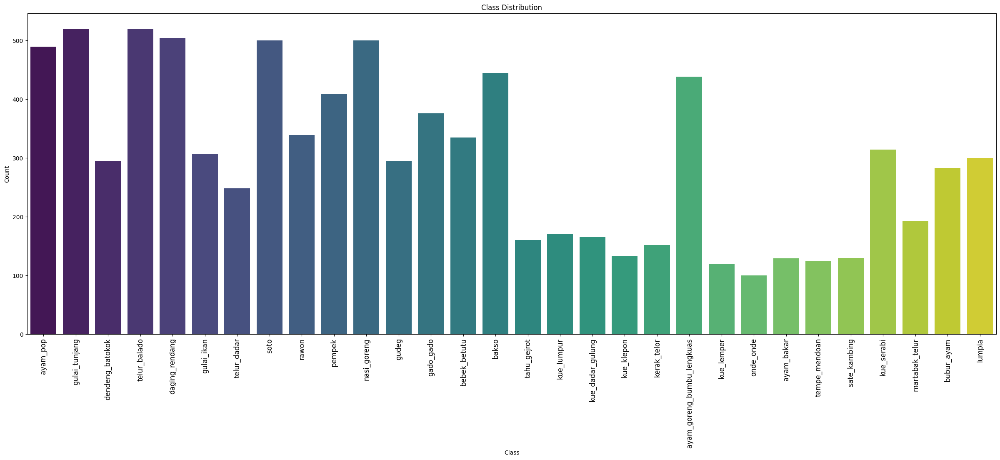

In [ ]:
dataset_dir = '/content/drive/MyDrive/[CC25-CF115] Kuliner Kita Capstone Project/Dataset/unprocessed_dataset'

class_distribution = {}
for class_name in os.listdir(dataset_dir):
  class_path = os.path.join(dataset_dir, class_name)
  if os.path.isdir(class_path):
    num_images = len(os.listdir(class_path))
    class_distribution[class_name] = num_images

print("class distribution:")

for  class_name, count in class_distribution.items():
  print(f"{class_name}: {count}")

# visualisasi distribusi data
plt.figure(figsize=(30, 10))
sns.barplot(x=list(class_distribution.keys()), y=list(class_distribution.values()), palette='viridis')
plt.title('Class Distribution')
plt.xlabel('Class', fontsize=10)
plt.xticks(rotation=90, fontsize=12)
plt.ylabel('Count', fontsize=10)
plt.show()

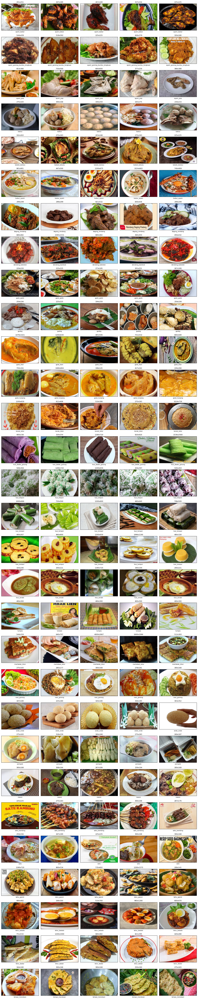

In [ ]:
# Membaca semua nama kelas (folder) dan gambar-gambarnya
food_images = {}
for class_name in sorted(os.listdir(dataset_dir)):
    class_path = os.path.join(dataset_dir, class_name)
    if os.path.isdir(class_path):
        food_images[class_name] = os.listdir(class_path)

# Menampilkan 5 gambar untuk setiap kelas
num_classes = min(30, len(food_images))
samples_per_class = 5

fig, axs = plt.subplots(num_classes, samples_per_class, figsize=(samples_per_class * 3, num_classes * 2.5))

for i, (class_name, image_list) in enumerate(food_images.items()):
    if i >= num_classes:
        break
    images = np.random.choice(image_list, samples_per_class, replace=False)

    for j, image_name in enumerate(images):
        img_path = os.path.join(dataset_dir, class_name, image_name)
        img = image.load_img(img_path)
        width, height = img.size

        axs[i, j].imshow(img)
        axs[i, j].set_title(f"{width}x{height}", fontsize=9)
        axs[i, j].set_xlabel(class_name, fontsize=8)
        axs[i, j].set_xticks([])
        axs[i, j].set_yticks([])
        axs[i, j].set_aspect('auto')

plt.tight_layout()
plt.show()

# data preprocessing

## spliting data

In [ ]:
def split_balanced_dataset(input_dir, output_dir, train_ratio=0.80, val_ratio=0.10, test_ratio=0.10):
    for cls in os.listdir(input_dir):
        cls_dir = os.path.join(input_dir, cls)
        if not os.path.isdir(cls_dir):
            continue

        images = [os.path.join(cls_dir, img) for img in os.listdir(cls_dir)
                  if img.lower().endswith(('.jpg', '.jpeg', '.png'))]

        random.shuffle(images)

        total_images = len(images)
        train_len = int(train_ratio * total_images)
        val_len = int(val_ratio * total_images)
        test_len = total_images - train_len - val_len

        split_data = {
            'train': images[:train_len],
            'val': images[train_len:train_len + val_len],
            'test': images[train_len + val_len:]
        }

        for split, files in split_data.items():
            split_cls_dir = os.path.join(output_dir, split, cls)
            os.makedirs(split_cls_dir, exist_ok=True)
            for file_path in files:
                shutil.copy(file_path, os.path.join(split_cls_dir, os.path.basename(file_path)))

        print(f"Kelas '{cls}': Total={total_images} | Train={train_len}, Val={val_len}, Test={test_len}")

    print("\nDataset berhasil di-split dengan rasio 80:10:10.")

split_balanced_dataset(dataset_dir, '/content/splited_dataset')


Kelas 'ayam_pop': Total=454 | Train=363, Val=45, Test=46
Kelas 'gulai_tunjang': Total=495 | Train=396, Val=49, Test=50
Kelas 'dendeng_batokok': Total=269 | Train=215, Val=26, Test=28
Kelas 'telur_balado': Total=489 | Train=391, Val=48, Test=50
Kelas 'daging_rendang': Total=504 | Train=403, Val=50, Test=51
Kelas 'gulai_ikan': Total=272 | Train=217, Val=27, Test=28
Kelas 'telur_dadar': Total=240 | Train=192, Val=24, Test=24
Kelas 'soto': Total=500 | Train=400, Val=50, Test=50
Kelas 'rawon': Total=339 | Train=271, Val=33, Test=35
Kelas 'pempek': Total=409 | Train=327, Val=40, Test=42
Kelas 'nasi_goreng': Total=500 | Train=400, Val=50, Test=50
Kelas 'gudeg': Total=295 | Train=236, Val=29, Test=30
Kelas 'gado_gado': Total=376 | Train=300, Val=37, Test=39
Kelas 'bebek_betutu': Total=335 | Train=268, Val=33, Test=34
Kelas 'bakso': Total=445 | Train=356, Val=44, Test=45
Kelas 'tahu_gejrot': Total=160 | Train=128, Val=16, Test=16
Kelas 'kue_lumpur': Total=170 | Train=136, Val=17, Test=17
Kelas 

## augmentasi data

In [ ]:
base_dir = '/content/splited_dataset'

train_dir = os.path.join(base_dir, 'train')
test_dir = os.path.join(base_dir, 'test')
val_dir = os.path.join(base_dir, 'val')

In [ ]:
kelas_train = [d for d in os.listdir(train_dir) if os.path.isdir(os.path.join(train_dir, d))]
print('kelas train : ', kelas_train)

kelas_test = [d for d in os.listdir(test_dir) if os.path.isdir(os.path.join(test_dir, d))]
print('kelas test : ', kelas_test)

kelas_val = [d for d in os.listdir(val_dir) if os.path.isdir(os.path.join(val_dir, d))]
print('kelas val : ', kelas_val)

kelas train :  ['ayam_bakar', 'tempe_mendoan', 'kue_lumpur', 'ayam_pop', 'nasi_goreng', 'bebek_betutu', 'kue_serabi', 'kue_klepon', 'onde_onde', 'bakso', 'telur_dadar', 'sate_kambing', 'telur_balado', 'gulai_tunjang', 'pempek', 'gado_gado', 'kue_lemper', 'gudeg', 'gulai_ikan', 'kerak_telor', 'dendeng_batokok', 'daging_rendang', 'martabak_telur', 'rawon', 'lumpia', 'kue_dadar_gulung', 'ayam_goreng_bumbu_lengkuas', 'soto', 'bubur_ayam', 'tahu_gejrot']
kelas test :  ['ayam_bakar', 'tempe_mendoan', 'kue_lumpur', 'ayam_pop', 'nasi_goreng', 'bebek_betutu', 'kue_serabi', 'kue_klepon', 'onde_onde', 'bakso', 'telur_dadar', 'sate_kambing', 'telur_balado', 'gulai_tunjang', 'pempek', 'gado_gado', 'kue_lemper', 'gudeg', 'gulai_ikan', 'kerak_telor', 'dendeng_batokok', 'daging_rendang', 'martabak_telur', 'rawon', 'lumpia', 'kue_dadar_gulung', 'ayam_goreng_bumbu_lengkuas', 'soto', 'bubur_ayam', 'tahu_gejrot']
kelas val :  ['ayam_bakar', 'tempe_mendoan', 'kue_lumpur', 'ayam_pop', 'nasi_goreng', 'bebek_

## augmentasi wajib

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    horizontal_flip=True,
    shear_range=0.2,
    fill_mode='nearest'
)

# Hanya rescale untuk Data Validasi (Tanpa Augmentasi)
validation_datagen = ImageDataGenerator(
    rescale=1./255
)

test_datagen = ImageDataGenerator(
    rescale=1./255
)

# Menggunakan Flow From Directory untuk Data Pelatihan
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(244, 244),
    color_mode='rgb',
    batch_size=64,
    class_mode='categorical',
    shuffle=True
)

# Menggunakan Flow From Directory untuk Data Validasi
validation_generator = validation_datagen.flow_from_directory(
    val_dir,
    target_size=(244, 244),
    color_mode='rgb',
    batch_size=64,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(244, 244),
    color_mode='rgb',
    batch_size=64,
    class_mode='categorical',
    shuffle=False
)


Found 7031 images belonging to 30 classes.
Found 869 images belonging to 30 classes.
Found 897 images belonging to 30 classes.


# membangun arsitektur model

## Bobot

In [ ]:

data_df = []

for dataset_type in ['train', 'test', 'val']:
  dataset_path = os.path.join(base_dir, dataset_type)

  if not os.path.isdir(dataset_path):
    continue

  for class_name in os.listdir(dataset_path):
    class_path = os.path.join(dataset_path, class_name)

    for image_name in os.listdir(class_path):
      if image_name.lower().endswith(('.jpg', '.jpeg', '.png')):
        image_path = os.path.join(class_path, image_name)
        data_df.append({
            'path' : image_path,
            'label' : class_name,
            'set' : dataset_type
        })

df_traditional_food = pd.DataFrame(data_df)
df_traditional_food.head()

,path,label,set
0,/content/splited_dataset/train/ayam_bakar/ayam...,ayam_bakar,train
1,/content/splited_dataset/train/ayam_bakar/ayam...,ayam_bakar,train
2,/content/splited_dataset/train/ayam_bakar/ayam...,ayam_bakar,train
3,/content/splited_dataset/train/ayam_bakar/ayam...,ayam_bakar,train
4,/content/splited_dataset/train/ayam_bakar/ayam...,ayam_bakar,train


In [ ]:
df_traditional_food['set'].value_counts()
df_traditional_food['label'].value_counts()

,count
label,
daging_rendang,504
nasi_goreng,500
soto,500
gulai_tunjang,495
telur_balado,489
ayam_pop,454
bakso,445
ayam_goreng_bumbu_lengkuas,432
pempek,409


In [ ]:
# menyesauaikan bobot
labels = df_traditional_food['label']

class_names = np.unique(labels)

class_weights_values = compute_class_weight(
    class_weight='balanced',
    classes=class_names,
    y=labels
)

class_weights = dict(zip(range(len(class_names)), class_weights_values))

# Cek hasilnya
print("Class Weights:", class_weights)

Class Weights: {0: np.float64(2.27312661498708), 1: np.float64(0.6787808641975308), 2: np.float64(0.6458883994126284), 3: np.float64(0.6589513108614232), 4: np.float64(0.8753233830845771), 5: np.float64(1.0361601884570082), 6: np.float64(0.5818121693121693), 7: np.float64(1.090086741016109), 8: np.float64(0.7798758865248226), 9: np.float64(0.9940112994350282), 10: np.float64(1.0780637254901961), 11: np.float64(0.5923905723905724), 12: np.float64(1.9291666666666667), 13: np.float64(1.7771717171717172), 14: np.float64(2.2384223918575064), 15: np.float64(3.153046594982079), 16: np.float64(1.7249019607843137), 17: np.float64(0.9398504273504273), 18: np.float64(0.9774444444444444), 19: np.float64(1.5193436960276339), 20: np.float64(0.5864666666666667), 21: np.float64(2.9323333333333332), 22: np.float64(0.7169519152404238), 23: np.float64(0.8649950835791543), 24: np.float64(2.2556410256410255), 25: np.float64(0.5864666666666667), 26: np.float64(1.8327083333333334), 27: np.float64(0.599659168

In [ ]:
base_model = Xception(weights='imagenet',
    include_top=False,
    input_shape=(244, 244, 3))

base_model.trainable = True

for layer in base_model.layers[:-30]:
    layer.trainable = False

base_model.summary()

83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


Model: "xception"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 244, 244,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1        │ (None, 121, 121,  │        864 │ input_layer[0][0] │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_bn     │ (None, 121, 121,  │        128 │ block1_conv1[0][… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_act    │ (None, 121, 121,  │          0 │ block1_conv1_bn[… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2        │ (None, 119, 119,  │     18,432 │ block1_conv1_act… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_bn     │ (None, 119, 119,  │        256 │ block1_conv2[0][… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_act    │ (None, 119, 119,  │          0 │ block1_conv2_bn[… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1     │ (None, 119, 119,  │      8,768 │ block1_conv2_act… │
│ (SeparableConv2D)   │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1_bn  │ (None, 119, 119,  │        512 │ block2_sepconv1[… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_act │ (None, 119, 119,  │          0 │ block2_sepconv1_… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2     │ (None, 119, 119,  │     17,536 │ block2_sepconv2_… │
│ (SeparableConv2D)   │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_bn  │ (None, 119, 119,  │        512 │ block2_sepconv2[… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 60, 60,    │      8,192 │ block1_conv2_act… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_pool         │ (None, 60, 60,    │          0 │ block2_sepconv2_… │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 60, 60,    │        512 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 60, 60,    │          0 │ block2_pool[0][0… │
│                     │ 128)              │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block3_sepconv1_act │ (None, 60, 60,    │          0 │ add[0][0]       

 Total params: 20,861,480 (79.58 MB)

 Trainable params: 8,940,352 (34.10 MB)

 Non-trainable params: 11,921,128 (45.48 MB)

In [ ]:
# Input layer
inputs = Input(shape=(244, 244, 3))
x = base_model(inputs, training=base_model.trainable)
x = GlobalAveragePooling2D()(x)

# FC layer 1
x = Dense(256, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.4)(x)

# FC layer 2
x = Dense(128, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.3)(x)

# FC layer 3
x = Dense(64, activation='relu')(x)
x = Dropout(0.2)(x)

# Output layer
outputs = Dense(30, activation='softmax')(x)

# Final model
model = Model(inputs, outputs)

In [ ]:
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 244, 244, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ xception (Functional)           │ (None, 8, 8, 2048)     │    20,861,480 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 30)             │         1,950 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 21,430,662 (81.75 MB)

 Trainable params: 9,508,766 (36.27 MB)

 Non-trainable params: 11,921,896 (45.48 MB)

In [ ]:
model.compile(
    loss = 'categorical_crossentropy',
    optimizer = tf.optimizers.Adam(),
    metrics = ['accuracy']
)

In [ ]:
# EarlyStopping callback
es = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=0.001,
    patience=10,
    verbose=1,
    restore_best_weights=True
)

# ReduceLROnPlateau callback
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=5,
    min_lr=1e-6,
    verbose=1
)

checkpoint = tf.keras.callbacks.ModelCheckpoint(
    filepath='best_model.h5',
    monitor='val_loss',
    save_best_only=True,
    verbose=1
)


# TensorBoard callback
tb = tf.keras.callbacks.TensorBoard(log_dir='tensorboard_logs')

# Training model

In [ ]:
# training model
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    verbose=2,
    callbacks=[es, lr_scheduler, tb, checkpoint],
    class_weight=class_weights
)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20

Epoch 1: val_loss improved from inf to 1.37584, saving model to best_model.h5


110/110 - 197s - 2s/step - accuracy: 0.3433 - loss: 2.3396 - val_accuracy: 0.6582 - val_loss: 1.3758 - learning_rate: 1.0000e-03
Epoch 2/20

Epoch 2: val_loss improved from 1.37584 to 0.91097, saving model to best_model.h5


110/110 - 142s - 1s/step - accuracy: 0.7265 - loss: 0.9318 - val_accuracy: 0.7560 - val_loss: 0.9110 - learning_rate: 1.0000e-03
Epoch 3/20

Epoch 3: val_loss improved from 0.91097 to 0.84476, saving model to best_model.h5


110/110 - 143s - 1s/step - accuracy: 0.8145 - loss: 0.6241 - val_accuracy: 0.7641 - val_loss: 0.8448 - learning_rate: 1.0000e-03
Epoch 4/20

Epoch 4: val_loss improved from 0.84476 to 0.78277, saving model to best_model.h5


110/110 - 128s - 1s/step - accuracy: 0.8575 - loss: 0.4615 - val_accuracy: 0.8113 - val_loss: 0.7828 - learning_rate: 1.0000e-03
Epoch 5/20

Epoch 5: val_loss improved from 0.78277 to 0.73421, saving model to best_model.h5


110/110 - 140s - 1s/step - accuracy: 0.8955 - loss: 0.3427 - val_accuracy: 0.8124 - val_loss: 0.7342 - learning_rate: 1.0000e-03
Epoch 6/20

Epoch 6: val_loss improved from 0.73421 to 0.62353, saving model to best_model.h5


110/110 - 128s - 1s/step - accuracy: 0.9110 - loss: 0.2895 - val_accuracy: 0.8470 - val_loss: 0.6235 - learning_rate: 1.0000e-03
Epoch 7/20

Epoch 7: val_loss did not improve from 0.62353
110/110 - 141s - 1s/step - accuracy: 0.9199 - loss: 0.2723 - val_accuracy: 0.8193 - val_loss: 0.8454 - learning_rate: 1.0000e-03
Epoch 8/20

Epoch 8: val_loss did not improve from 0.62353
110/110 - 126s - 1s/step - accuracy: 0.9216 - loss: 0.2713 - val_accuracy: 0.8274 - val_loss: 0.8328 - learning_rate: 1.0000e-03
Epoch 9/20

Epoch 9: val_loss did not improve from 0.62353
110/110 - 142s - 1s/step - accuracy: 0.9408 - loss: 0.1806 - val_accuracy: 0.8274 - val_loss: 0.7785 - learning_rate: 1.0000e-03
Epoch 10/20

Epoch 10: val_loss did not improve from 0.62353
110/110 - 126s - 1s/step - accuracy: 0.9509 - loss: 0.1581 - val_accuracy: 0.8654 - val_loss: 0.6901 - learning_rate: 1.0000e-03
Epoch 11/20

Epoch 11: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.

Epoch 11: val_loss did not

110/110 - 142s - 1s/step - accuracy: 0.9713 - loss: 0.0975 - val_accuracy: 0.8930 - val_loss: 0.4521 - learning_rate: 5.0000e-04
Epoch 13/20

Epoch 13: val_loss did not improve from 0.45212
110/110 - 141s - 1s/step - accuracy: 0.9818 - loss: 0.0682 - val_accuracy: 0.8918 - val_loss: 0.4543 - learning_rate: 5.0000e-04
Epoch 14/20

Epoch 14: val_loss did not improve from 0.45212
110/110 - 125s - 1s/step - accuracy: 0.9807 - loss: 0.0634 - val_accuracy: 0.8803 - val_loss: 0.5353 - learning_rate: 5.0000e-04
Epoch 15/20

Epoch 15: val_loss did not improve from 0.45212
110/110 - 142s - 1s/step - accuracy: 0.9848 - loss: 0.0499 - val_accuracy: 0.8918 - val_loss: 0.4811 - learning_rate: 5.0000e-04
Epoch 16/20

Epoch 16: val_loss did not improve from 0.45212
110/110 - 142s - 1s/step - accuracy: 0.9859 - loss: 0.0439 - val_accuracy: 0.8964 - val_loss: 0.4801 - learning_rate: 5.0000e-04
Epoch 17/20

Epoch 17: ReduceLROnPlateau reducing learning rate to 0.0002500000118743628.

Epoch 17: val_loss d

110/110 - 127s - 1s/step - accuracy: 0.9929 - loss: 0.0274 - val_accuracy: 0.9091 - val_loss: 0.3948 - learning_rate: 2.5000e-04
Epoch 19/20

Epoch 19: val_loss did not improve from 0.39479
110/110 - 126s - 1s/step - accuracy: 0.9920 - loss: 0.0238 - val_accuracy: 0.9091 - val_loss: 0.4295 - learning_rate: 2.5000e-04
Epoch 20/20

Epoch 20: val_loss improved from 0.39479 to 0.37763, saving model to best_model.h5


110/110 - 125s - 1s/step - accuracy: 0.9946 - loss: 0.0197 - val_accuracy: 0.9148 - val_loss: 0.3776 - learning_rate: 2.5000e-04
Restoring model weights from the end of the best epoch: 20.


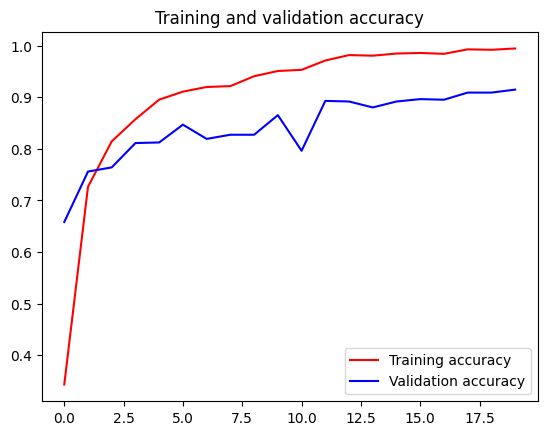

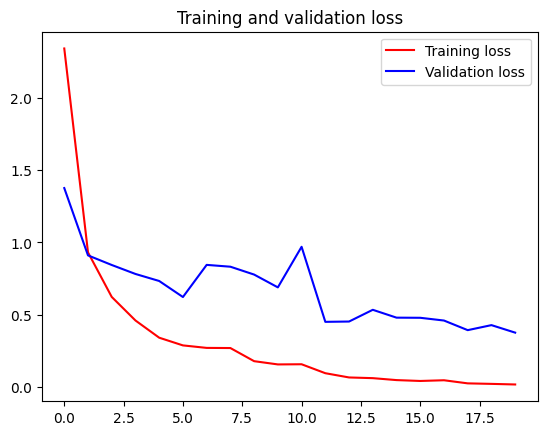

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.figure()
plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()
plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

# evaluasi dan visualisasi

In [ ]:
# Evaluasi model menggunakan data pengujian

model_fix = load_model('/content/best_model.h5')
evaluation = model_fix.evaluate(
    test_generator,
    steps=test_generator.samples
)

# Menampilkan hasil evaluasi
print("Loss:", evaluation[0])
print("Accuracy:", evaluation[1])

897/897 ━━━━━━━━━━━━━━━━━━━━ 12s 9ms/step - accuracy: 0.9140 - loss: 0.4095   


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/epoch_iterator.py:107: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


Loss: 0.4088757634162903
Accuracy: 0.914158284664154


15/15 ━━━━━━━━━━━━━━━━━━━━ 13s 694ms/step


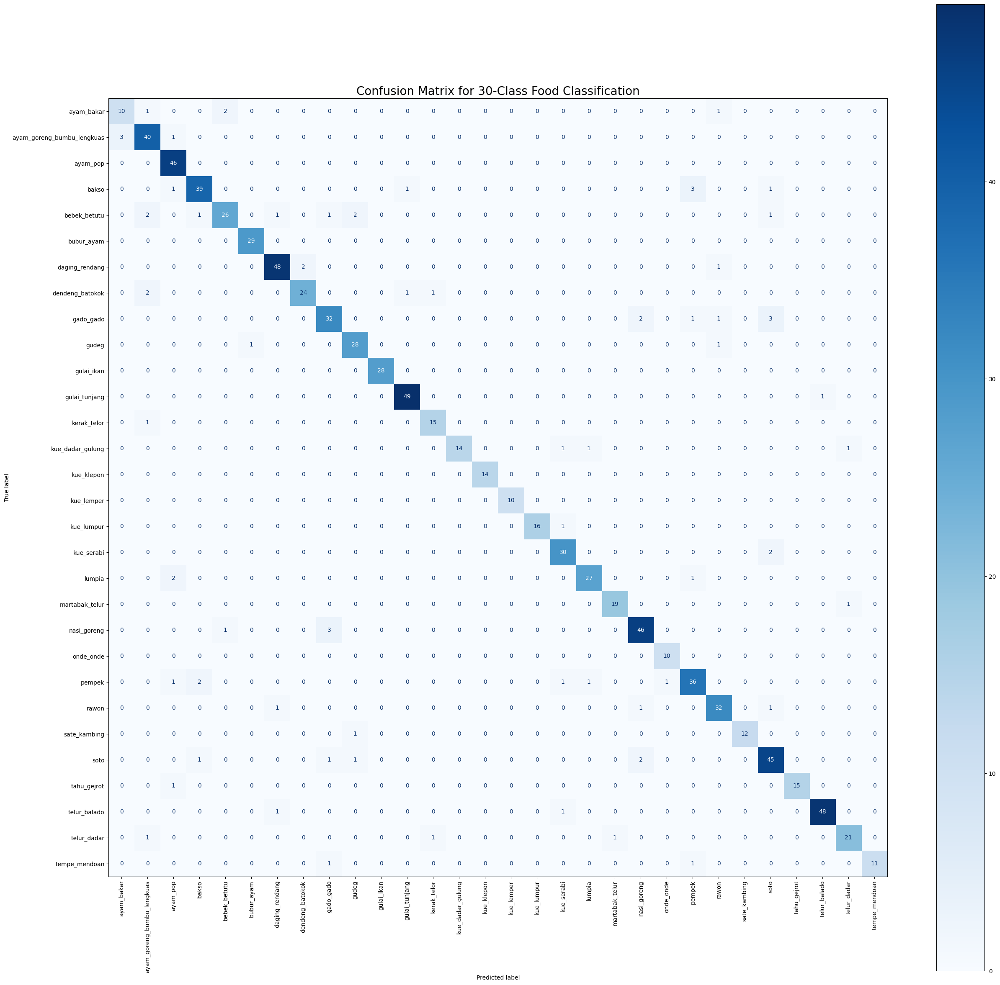

Classification Report:


,precision,recall,f1-score,support
ayam_bakar,0.77,0.71,0.74,14
ayam_goreng_bumbu_lengkuas,0.85,0.91,0.88,44
ayam_pop,0.88,1.00,0.94,46
bakso,0.91,0.87,0.89,45
bebek_betutu,0.90,0.76,0.83,34
bubur_ayam,0.97,1.00,0.98,29
daging_rendang,0.94,0.94,0.94,51
dendeng_batokok,0.92,0.86,0.89,28
gado_gado,0.84,0.82,0.83,39
gudeg,0.88,0.93,0.90,30


In [ ]:
# Prediksi probabilitas dari test generator
y_true = test_generator.classes
y_pred_probs = model.predict(test_generator, verbose=1)
y_pred = np.argmax(y_pred_probs, axis=1)

# Ambil nama kelas dari test_generator
class_names = list(test_generator.class_indices.keys())

# Confusion Matrix
cm = confusion_matrix(y_true, y_pred)
fig, ax = plt.subplots(figsize=(30, 30))  # ini akan diperhitungkan
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues, xticks_rotation=90, values_format='d', ax=ax)
plt.title("Confusion Matrix for 30-Class Food Classification", fontsize=20)
plt.grid(False)
plt.show()

# Classification Report as Table
report = classification_report(y_true, y_pred, target_names=class_names, output_dict=True)
report_df = pd.DataFrame(report).transpose()

# Tampilkan ringkasan classification report
print("Classification Report:")
display(report_df.style.format({
    'precision': '{:.2f}',
    'recall': '{:.2f}',
    'f1-score': '{:.2f}',
    'support': '{:.0f}'
}).background_gradient(cmap='Blues', subset=['precision', 'recall', 'f1-score']))

# konversi model

In [ ]:
files.download('/content/best_model.h5')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Konversi model H5 ke TensorFlow.js
!tensorflowjs_converter \
    --input_format=keras \
    /content/best_model.h5 \
    /content/modeltfjs

#  unduh folder hasilnya
shutil.make_archive('/content/modeltfjs', 'zip', '/content', 'modeltfjs')
files.download('/content/modeltfjs.zip')

2025-05-21 18:00:20.969161: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1747850420.990211   30986 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1747850420.996993   30986 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
🌲 Try https://ydf.readthedocs.io, the successor of TensorFlow Decision Forests with more features and faster training!
failed to lookup keras version from the file,
    this is likely a weight only file


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Menyimpan model ke SavedModel format
save_path = '/content/saved_model/'
tf.saved_model.save(model, save_path)

# mendownload model dalam format zip karena kode ini dijalankan di google colab
shutil.make_archive('/content/saved_model', 'zip', save_path)
files.download('/content/saved_model.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
with open('/content/label.txt', 'w') as f:
    for class_name in class_names:
        f.write(f"{class_name}\n")

In [ ]:
import tensorflow as tf

keras_model_path = '/content/best_model.h5'  # Ganti dengan path yang sesuai

keras_model = tf.keras.models.load_model(keras_model_path)

# Konversi model Keras ke model TFLite
converter = tf.lite.TFLiteConverter.from_keras_model(keras_model)
tflite_model = converter.convert()

# Simpan model TFLite ke dalam file .tflite
with tf.io.gfile.GFile('model.tflite', 'wb') as f:
    f.write(tflite_model)


class_names = sorted(os.listdir(train_dir))

# Simpan nama kelas ke dalam file label.txt
with open('/content/label.txt', 'w') as f:
    for class_name in class_names:
        f.write(f"{class_name}\n")

shutil.make_archive('/content/model', 'zip', '/content', 'model.tflite', 'label.txt')
files.download('/content/model.zip')

Saved artifact at '/tmp/tmpg4lhmk09'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 244, 244, 3), dtype=tf.float32, name='input_layer_1')
Output Type:
  TensorSpec(shape=(None, 30), dtype=tf.float32, name=None)
Captures:
  137248102477712: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137248102476368: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137248102475984: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137248102476176: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137248102477520: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137248102474832: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137248102474448: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137248102473872: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137248102474256: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137248102476944: TensorSpec(shape=(), dtype=tf.resource, name=None)
  137248102472

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Inferensi

Saving Screenshot 2025-05-21 233132.png to Screenshot 2025-05-21 233132 (2).png


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
Prediksi per label:
ayam_bakar                    : 0.0000
ayam_goreng_bumbu_lengkuas    : 0.0000
ayam_pop                      : 0.0000
bakso                         : 0.0000
bebek_betutu                  : 0.0000
bubur_ayam                    : 0.0001
daging_rendang                : 0.0000
dendeng_batokok               : 0.0000
gado_gado                     : 0.0000
gudeg                         : 0.0000
gulai_ikan                    : 0.0000
gulai_tunjang                 : 0.0000
kerak_telor                   : 0.0000
kue_dadar_gulung              : 0.0003
kue_klepon                    : 0.9983
kue_lemper                    : 0.0001
kue_lumpur                    : 0.0000
kue_serabi                    : 0.0008
lumpia                        : 0.0000
martabak_telur                : 0.0000
nasi_goreng                   : 0.0000
onde_onde                     : 0.0002
pempek                        : 0.0000
rawon                         : 0.0000
sate_kam

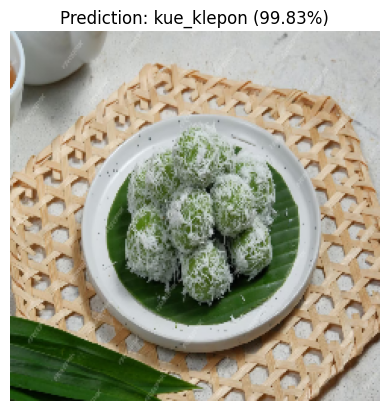

In [ ]:
# Upload gambar
uploaded = files.upload()
image_path = list(uploaded.keys())[0]

# Load label dari file
with open('/content/label.txt', 'r') as f:
    labels = [line.strip() for line in f.readlines()]

# Load model H5
model = tf.keras.models.load_model("/content/best_model (1).h5")

# Preprocessing gambar
img = image.load_img(image_path, target_size=(244, 244))  # sesuaikan dengan input model
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)  # tambahkan dimensi batch
img_array = img_array.astype(np.float32) / 255.0  # normalisasi

# Inference
predictions = model.predict(img_array)[0]

# menampilkan hasil prediksi semua label
print("Prediksi per label:")
for label, prob in zip(labels, predictions):
    print(f"{label:<30}: {prob:.4f}")

# Prediksi tertinggi
max_index = np.argmax(predictions)
predicted_label = labels[max_index]
confidence = predictions[max_index]

# Menampilkan gambar dan hasil prediksi
plt.imshow(img)
plt.axis("off")
plt.title(f"Prediction: {predicted_label} ({confidence:.2%})")
plt.show()

In [ ]:
# Ganti ini dengan path folder yang ingin kamu hapus
folder_path = '/content/splited_dataset'

# Cek apakah folder tersebut ada
if os.path.exists(folder_path):
    shutil.rmtree(folder_path)
    print(f"Folder '{folder_path}' berhasil dihapus.")
else:
    print(f"Folder '{folder_path}' tidak ditemukan.")

Folder '/content/splited_dataset' berhasil dihapus.
